## Tugas
* Lakukan klasifikasi pada data MNIST dengan menggunakan model ANN

* Anda diperbolehkan melakukan eksplorasi terhadap,

  * Metode pra pengolahan
  * Pemilihan fitur

  * Arsitektur ANN

  * Fungsi Aktiviasi

* ANN diimplementasikan dengan menggunakan tensorflow.

* DIKERJAKAN SECARA BERKELOMPOK

* JELASKAN HASIL YANG ANDA DAPATKAN,

  * AKURASI

  * CONFUSION MATRIX

  * KONFIGURASI MODEL --> MULAI DARI PRA PENGOLAHAN SAMPAI ARSITEKTUR ANN

Import library

In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
from sklearn.metrics import confusion_matrix, accuracy_score
import seaborn as sns
from tensorflow.keras.utils import to_categorical

Load dan split data

In [ ]:
from google.colab import files
files.upload()

Saving mnist.npz to mnist.npz


{'mnist.npz': b'PK\x03\x04\x14\x00\x00\x00\x08\x00\xbb\x89QJ2a HC\xf0\x18\x00P\xa1w\x00\n\x00\x00\x00x_test.npy\xec}\x07|T\xc5\xf6\xff5\t=\xa1\x87\x8eDzSJ\x04DA\xa2\x02\x02" \x8f\xa6\x80\xa0\x08\x82 ]\x14A\x88\xf4\xae\xd2\xbb\xf4\x12\xa5\xf7\x9a\xd0B\t\x10\x02$\xa1\x07BHOHo;\xe7\xec\x7f\xee\xdd\xddd\xef\x9d9\xfb\xde\xf3\xf7\xde\xfbK9~L\x96\xfdf\xee\x9d\xb9e\xe6\xcc)\xdf\xb3\xa8S\xf7\x8f\xbb|\xfa\x8a\xd2V\x99P\xeb\xab\x81c\x06\x8c\xae\xf5\xb6G\xad\x89\xdf5\xaaU\xdf\xa3\xd6\xa0\x11\xa3\xc7\x8e\xfebx\xbf\x11\xa3\xbf\x1a\xa8~\xdf\xf6\x8bac\x06\xf2\xef\xc7\x0c\xfeb\xe4@\xfe\xef\xda\x8d\x1ar\xa9\xef\xd1\xf8-\xf5\xff:\xf5=~\xf2(\xac<7\xd2\xed\xc8\xef\xcbZT\x97c\x0f\x90K\xb2\xbfU|\xde\xb4\xc7>\x18\xddn\xf4\xc6\xc7\xf8\x88\xffE\xce\x13\xc4yB\xe3\x12\xef\x17\xfd\xe0\x83\x0f\xdeq\x8f\xc7o\xa8s\xff\x03\x82J\x12P\x99\x18\xf3?\xa8f?cb}\x02z\'\x1b\xdf\xa5\x9aM\xc7c\xf9\x08\xa8\xd0\x95\xac\xb7\xa9f\x93\xf0 \x05}dJjN@\xa5\xee\xe3\x16\x02r\x0e\xc0\xbb\xd5\x08\xac&\xe2\xc7\x04T\xe5!\x8ey\x85\xc0\xa6#\xbe

In [10]:
df = np.load('mnist.npz')
df.files

['x_test', 'x_train', 'y_train', 'y_test']

In [11]:
X_test = df['x_test']
X_train = df['x_train']
y_test = df['y_test']
y_train = df['y_train']

Pre-Processing

In [12]:
# Normalisasi data ke rentang [0, 1]
X_train = X_train.astype('float32') / 255
X_test = X_test.astype('float32') / 255

In [13]:
# Ubah dimensi data menjadi vektor 1D (784 fitur dari 28x28 piksel)
X_train = X_train.reshape((X_train.shape[0], 28 * 28))
X_test = X_test.reshape((X_test.shape[0], 28 * 28))

In [14]:
# One-hot encoding untuk label
y_train = to_categorical(y_train)
y_test = to_categorical(y_test)

Arsitektur ANN

In [15]:
ann = tf.keras.models.Sequential()

In [16]:
ann.add(tf.keras.layers.Dense(units=64, activation='relu'))

In [17]:
ann.add(tf.keras.layers.Dense(units=32, activation='relu'))

In [18]:
ann.add(tf.keras.layers.Dense(units=10, activation='softmax'))

Training Model

In [19]:
ann.compile(optimizer = 'adam', loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [20]:
ann.fit(X_train, y_train, batch_size = 100, epochs = 100)

Epoch 1/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.7982 - loss: 0.6784
Epoch 2/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.9478 - loss: 0.1805
Epoch 3/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9595 - loss: 0.1395
Epoch 4/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9673 - loss: 0.1090
Epoch 5/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9734 - loss: 0.0885
Epoch 6/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9773 - loss: 0.0769
Epoch 7/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9798 - loss: 0.0686
Epoch 8/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 4s 5ms/step - accuracy: 0.9838 - loss: 0.0534
Epoch 9/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 4s 3ms/step - accuracy: 0.9851 - loss: 0.0485
Epoch 10/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 3s 3ms/step - accuracy: 0.9878 - loss: 0.0422
Epoch 11/100
600/600 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.9895 - loss: 0.0366
Epoch 12/100
600/600 ━━━━━━━━━━━━━━━━━━━━

Cek Akurasi dan Confusion Matrix

313/313 ━━━━━━━━━━━━━━━━━━━━ 2s 7ms/step
313/313 ━━━━━━━━━━━━━━━━━━━━ 3s 5ms/step - accuracy: 0.9732 - loss: 0.2264
Test accuracy: 0.9769


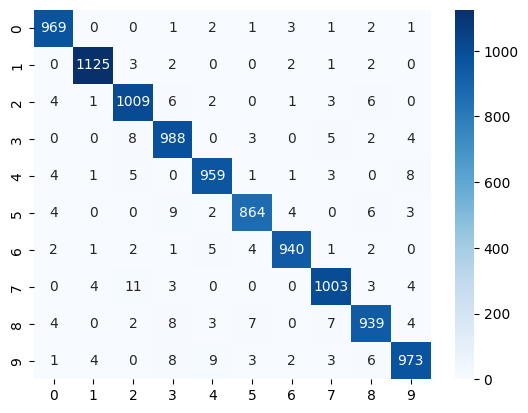

In [21]:
y_pred = ann.predict(X_test)
# Mengubah prediksi probabilitas ke label kelas
y_pred_classes = np.argmax(y_pred, axis=1)  # Mengambil kelas dengan probabilitas tertinggi
y_true_classes = np.argmax(y_test, axis=1)  # Mengambil kelas sebenarnya

# Menghitung confusion matrix
cm = confusion_matrix(y_true_classes, y_pred_classes)

# Menampilkan accuracy
test_loss, test_acc = ann.evaluate(X_test, y_test)
print(f"Test accuracy: {test_acc:.4f}")

sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
accuracy = np.sum(y_true_classes == y_pred_classes) / y_true_classes.shape[0]